## Quality control for PPI analysis 

This notebook presents basic quality control analysis for PPI beta-weights. Input data consists of set of beta-weights matrices for each subject and task condition. Each beta-weight matrix is $N_{rois} \times N_{rois} \times N_{regressors}$ matrix aggregating all regressors. Each element $(i, j, k)$ corresponds to $\hat{\beta_k}$ estimate for linear model in which modeled response (target $y$) is $i$th ROI timeresies and physiological regressor (seed $x_{physio}$) is $j$th ROI timeseries. Beta-weight matices are not symmetric, which is particularly apparent for psychological regressors. Beta-weight matrix for physiological regressor roughly represents standard resting state correlation matrix.   

---
**Last update**: 18.05.2020

In [1]:
%matplotlib inline
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
import os

from nilearn import plotting
from statsmodels.stats.multitest import multipletests
import scipy.stats

path_root = os.environ.get('DECIDENET_PATH')
path_code = os.path.join(path_root, 'code')
if path_code not in sys.path:
    sys.path.append(path_code)
from dn_utils.behavioral_models import load_behavioral_data

In [2]:
# Directory for PPI analysis
path_out = os.path.join(path_root, 'data/main_fmri_study/derivatives/ppi')
path_networks = os.path.join(path_out, 'networks')
path_parcellations = os.path.join(path_out, 'parcellations')
path_300_roi = os.path.join(path_parcellations, '300_ROI_Set/ROIs_300inVol_MNI_allInfo.txt')
df_atlas = pd.read_csv(path_300_roi, sep=' ')

# Load behavioral data
path_beh = os.path.join(path_root, 'data/main_fmri_study/sourcedata/behavioral')
beh, meta = load_behavioral_data(path=path_beh, verbose=False)
n_subjects, n_conditions, n_trials, _ = beh.shape
n_rois, n_nets = 300, 14
n_regressors = 10

# Get specific version
analysis = 'betamats_1s_perr_full'
path_betamats = os.path.join(path_networks, analysis)

### Prepare brain parcellation
- create short network names (for visualisation purpose)
- reorder nodes accortding to large-scale network membership (for better visual inspection)
- save reordered atlas to csv

In [3]:
net_names_short = {
    'unassigned': 'UN',
    'SomatomotorDorsal': 'SOMD',
    'SomatomotorLateral': 'SOML',
    'CinguloOpercular': 'CO',
    'Auditory': 'AU',
    'DefaultMode': 'DM',
    'ParietoMedial': 'PM',
    'Visual': 'VIS',
    'FrontoParietal': 'FP',
    'Salience': 'SAL',
    'VentralAttention': 'VA',
    'DorsalAttention': 'DA',
    'MedialTemporalLobe': 'MTL',
    'Reward': 'REW'
}

df_atlas['netName'] = df_atlas['netName'].astype('category')
df_atlas['netName_short'] = pd.Series(map(lambda key: net_names_short[key], df_atlas['netName']))

labels = df_atlas['netName']

new_index = []
for label in labels.unique():
    new_index += list(labels[labels==label].index)
    
df_atlas = df_atlas.reindex(new_index)
df_atlas = df_atlas.reset_index()
df_atlas.head()

df_atlas.to_csv(
    os.path.join(path_parcellations, '300_ROI_Set/ROIs_300inVol_MNI_allInfo_reordered.txt'),
    sep=' ')

### Load beta matrices 

Since PPI GLM is not symmetric, i.e. yields different $\beta$ values for target region $i$ / seed region $j$ and target region $j$ / seed region $i$ two versions of aggregated PPI matrices are created:
- `beta_mats_all`: with original $\beta$ values
- `beta_mats_all_sym`: symmetrized versions of original matrices ($A_{sym}=\frac{A+A^T}{2}$)

Both aggregated matrices have size $N_{subjects}\times N_{conditions} \times N_{rois} \times N_{rois} \times N_{regressors}$. For example in order to get PPI matrix for interaction of **connectivity between ROIs** and **prediction error** for subject `sub` and condtion `con`, one must get slice `beta_mats_all_sym[sub, con, :, :, 4]`. Additional variables store:
- `beta_mats_mean`: mean $\beta$ matrices for each condition (and regressor)
- `beta_mats_std`: matrices of $\beta$ standard deviation for each condition (and regressor)
- `beta_mean`: mean node strength ($\beta$) value for each subject and condition (and regressor)
- `beta_std`: standard deviation of node strenght ($\beta$) for each subject and condition (and regressor)

Additionally, within and between large scale networks $\beta$ values are calculated and stored in `nets_mats_all_sym`.

In [4]:
regressors = ['physio', 'perr_onset', 'perr_sign', 'ppi_perr_onset', 'ppi_per_sign',
              'dec_ons', 'res_lbp', 'res_rbp', 'res_miss', 'reg_intercept']

beta_mats_all = np.zeros((n_subjects, n_conditions, n_rois, n_rois, n_regressors))
beta_mats_all_sym = np.zeros((n_subjects, n_conditions, n_rois, n_rois, n_regressors))

for sub, sub_name in enumerate(meta['dim1']):
    for con, con_name in enumerate(meta['dim2']):
        # Load individual files
        fname = f'sub-{sub_name}_task-{con_name}_betamats.npy'
        beta_mats = np.load(os.path.join(path_betamats, fname))
        beta_mats_sym = (beta_mats + np.transpose(beta_mats, [1, 0, 2])) / 2
        
        # Reorder nodes according to large scale networks
        beta_mats = beta_mats[df_atlas['index']][:, df_atlas['index']]        
        beta_mats_sym = beta_mats_sym[df_atlas['index']][:, df_atlas['index']]
        
        # Aggregate
        beta_mats_all[sub, con] = beta_mats
        beta_mats_all_sym[sub, con] = beta_mats_sym

# Mean over subjects
beta_mats_mean = np.mean(beta_mats_all, axis=0)        
beta_mats_mean_sym = np.mean(beta_mats_all_sym, axis=0)

# Matrix mean and std
beta_mean = np.mean(beta_mats_all_sym, axis=(2, 3))
beta_std = np.std(beta_mats_all_sym, axis=(2, 3))

# Normalize
normalize = False
if normalize:
    beta_mats_all_sym = ((beta_mats_all_sym - np.expand_dims(beta_mean, axis=(2, 3))) 
                        / np.expand_dims(beta_std, axis=(2, 3)))
    beta_mats_mean_sym = np.mean(beta_mats_all_sym, axis=0)

# Large-scale network aggregation
nets_mats_all_sym = np.zeros((n_subjects, n_conditions, n_nets, n_nets, n_regressors))
for i, net_i in enumerate(net_names_short.values()):
    for j, net_j in enumerate(net_names_short.values()):
        net_i_indices = df_atlas[df_atlas['netName_short'] == net_i].index
        net_j_indices = df_atlas[df_atlas['netName_short'] == net_j].index
        nets_mats_all_sym[:, :, i, j, :] = np.mean(
            beta_mats_all_sym[:, :, net_i_indices, :, :][:, :, :, net_j_indices, :], 
            axis=(2, 3))
        
nets_mats_mean_sym = np.mean(nets_mats_all_sym, axis=0)

### Plot mean beta-weights matrices

Inspect mean beta-weights matrices (mean over subjects) for both conditions and all regressors. Each figure row corresponds to different regressor from PPI linear model. Third column presents difference between mean matrix for reward and punishment condition. Note that not symmetrized versions of matrices are presented. Additional grid lines are shown to emphasize boundaries between large-scale networks. 

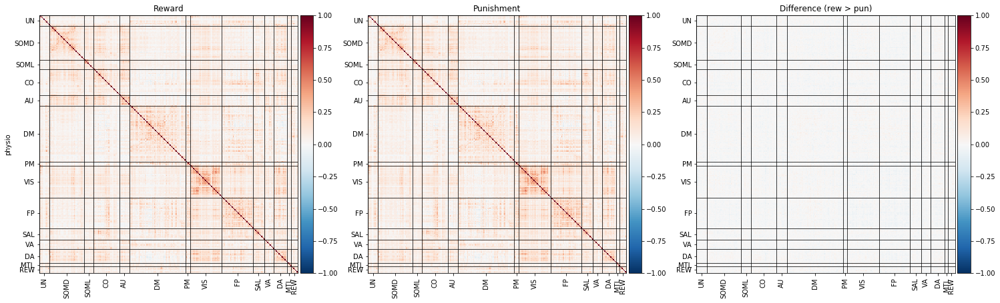

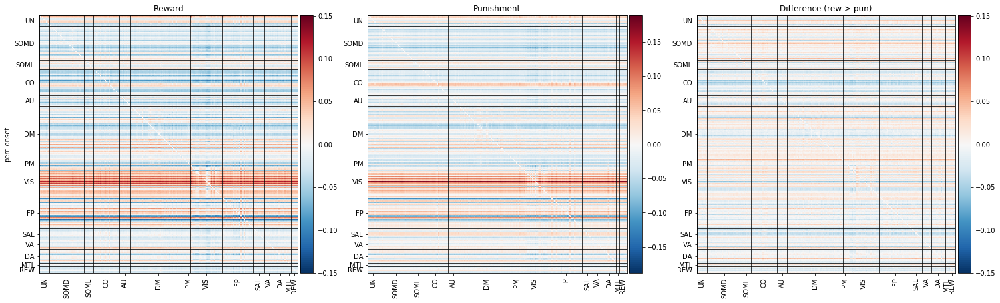

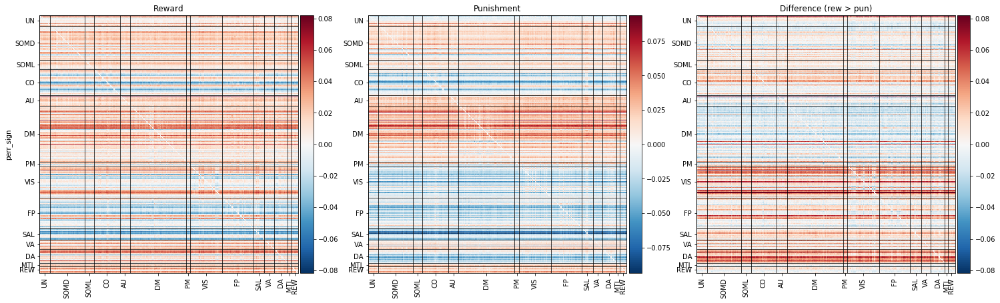

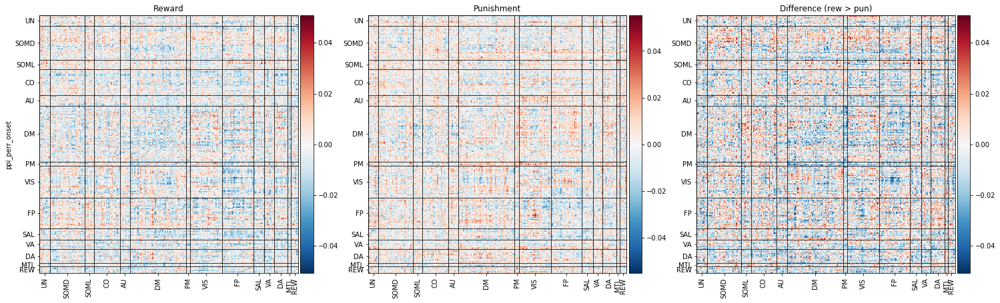

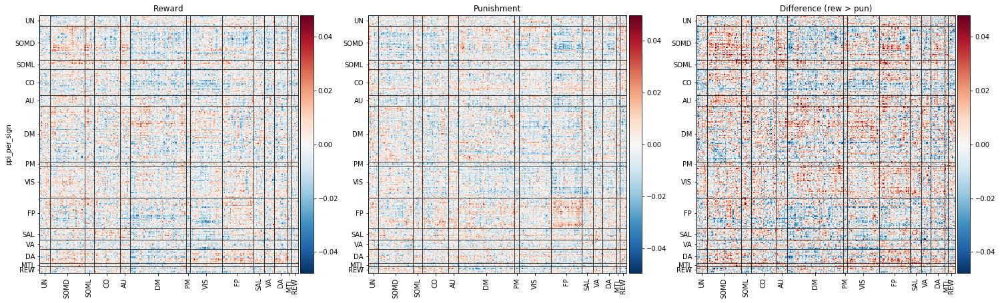

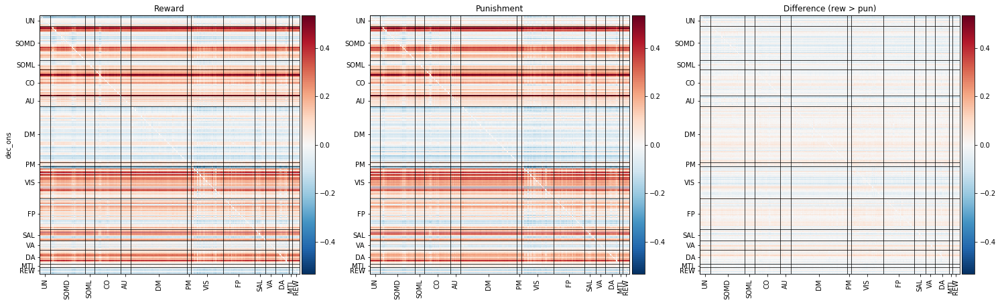

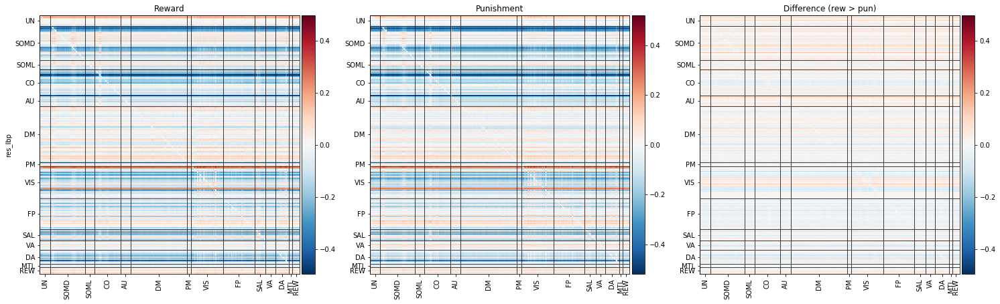

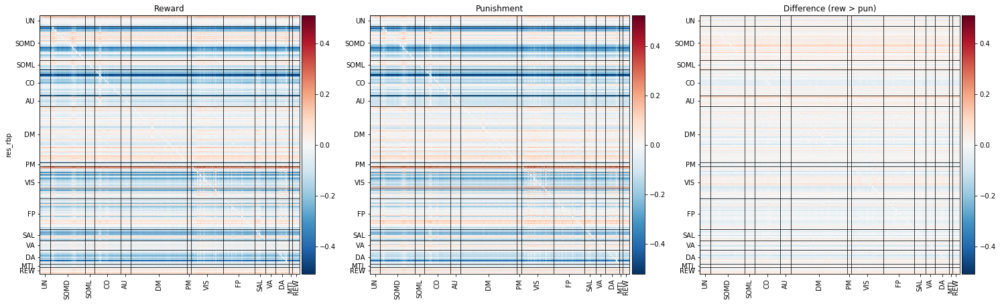

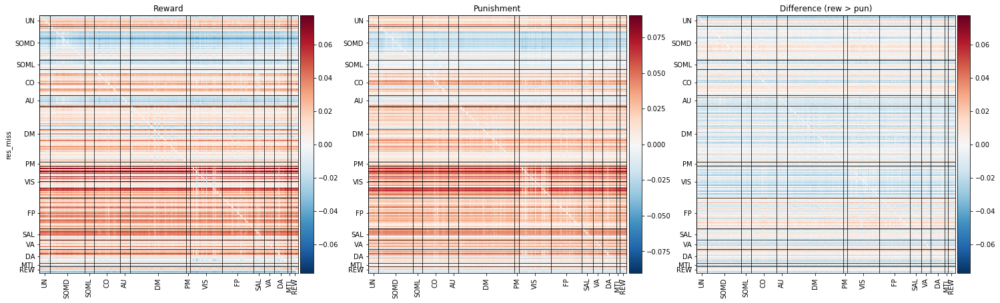

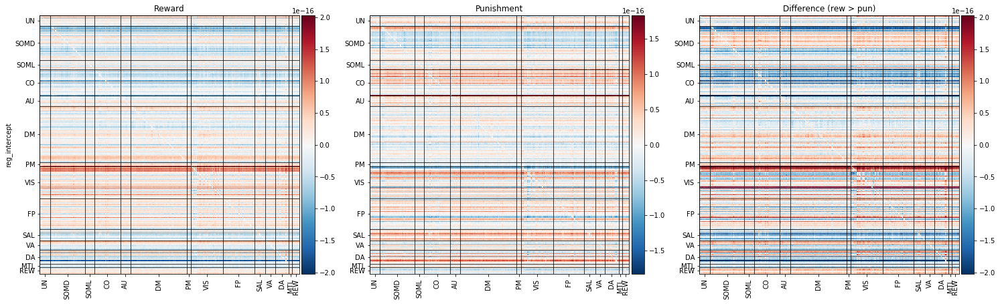

In [5]:
for m, regressor in enumerate(regressors):

    fig, axs = plt.subplots(figsize=(25, 8), ncols=3, facecolor='w')

    ims = [None] * 3
    ims[0] = axs[0].imshow(beta_mats_mean[0, :, :, m], 'RdBu_r', origin='upper')
    ims[1] = axs[1].imshow(beta_mats_mean[1, :, :, m], 'RdBu_r', origin='upper')
    ims[2] = axs[2].imshow(beta_mats_mean[0, :, :, m] - \
                           beta_mats_mean[1, :, :, m], 'RdBu_r', origin='upper')

    axs[0].set_ylabel(regressor)
    axs[0].set_title('Reward')
    axs[1].set_title('Punishment')
    axs[2].set_title('Difference (rew > pun)')
    
    for im in ims[:2]:
        clim = im.get_clim()
        im.set_clim([-np.max(np.abs((im.get_clim()))), np.max(np.abs((im.get_clim())))])
    ims[-1].set_clim(ims[0].get_clim())

    for im, ax in zip(ims, axs):
        boundaries = df_atlas['netName'].cat.codes.diff() != 0
        boundaries = np.array(boundaries[boundaries].index) - .5
        boundaries = np.append(boundaries, [n_rois - .5])
        tick_positions = [(b1+b2)/2 for b1, b2 in zip(boundaries, boundaries[1:])] 

        for boundary in boundaries:
            ax.axvline(x=boundary, color='k', linewidth=1, alpha=.75)
            ax.axhline(y=boundary, color='k', linewidth=1, alpha=.75)

        ax.set_xticks(tick_positions)
        ax.set_yticks(tick_positions)
        ax.set_xticklabels(df_atlas['netName_short'].unique(), rotation=90)
        ax.set_yticklabels(df_atlas['netName_short'].unique())

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

    plt.show()

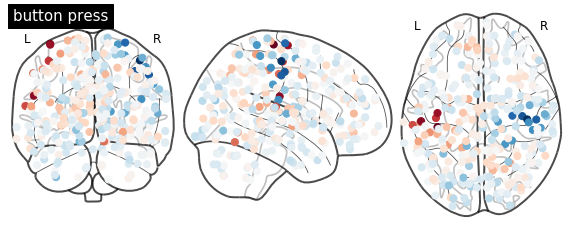

In [6]:
# Sanity check: button press contrast
node_strenght = np.mean(np.mean(beta_mats_mean, axis=0)[:, :, 7] \
                      - np.mean(beta_mats_mean, axis=0)[:, :, 6], 
                        axis=1)
max_strenght = np.max(np.abs(node_strenght))
node_colors = [cm.RdBu_r(((s * 2 / max_strenght) + 1) / 2) for s in node_strenght]

fig, ax = plt.subplots(figsize=(10, 4))

plotting.plot_connectome(
    np.zeros((n_rois, n_rois)),
    node_coords=df_atlas.loc[:, ['x', 'y', 'z']],
    node_color=node_colors,
    axes=ax,
    title='button press'
)
plt.show()

## Analyze single regressor

In [7]:
regressor_id = 4

### Plot individual beta-weights matrices

Inspect individual beta-weights matrices for subjects and task conditions. `regressor_id` specifies which regressor (from PPI model) should be inspected, i.e. beta-weight matrices for corresponding regressors are plotted. If `standardized` is True, all beta-weights for given matrix are standardized (mean centered and divided by its standard deviation). Upper triangles of each matrix represents reward condition, lower triangles represents punishment condition.

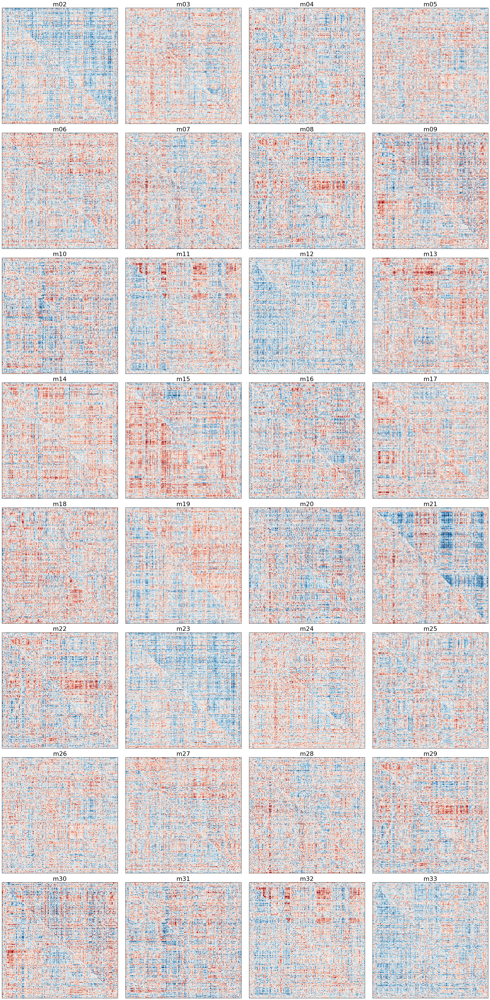

In [8]:
standardized = False

fig, ax = plt.subplots(nrows=8, ncols=4, figsize=(25, 50), facecolor='w')

for sub, sub_name in enumerate(meta['dim1']):
    
    if standardized:
        A_rew = ((beta_mats_all_sym[sub, 0, :, :, regressor_id] - beta_mean[sub, 0, regressor_id]) 
                 / beta_std[sub, 0, regressor_id])
        A_pun = ((beta_mats_all_sym[sub, 1, :, :, regressor_id] - beta_mean[sub, 1, regressor_id]) 
                 / beta_std[sub, 1, regressor_id])
    else:
        A_rew = beta_mats_all_sym[sub, 0, :, :, regressor_id]
        A_pun = beta_mats_all_sym[sub, 1, :, :, regressor_id]
    
    A = np.triu(A_rew, 1) + \
        np.tril(A_pun, -1)
    
    clim = (-3, 3) if standardized else (-3 * np.mean(beta_std, axis=(0, 1))[regressor_id],
                                          3 * np.mean(beta_std, axis=(0, 1))[regressor_id])
    
    cur_ax = ax[sub // 4][sub % 4]
    cur_im = cur_ax.imshow(A, cmap='RdBu_r', clim=clim)
    cur_ax.set_title(sub_name, fontSize=22)
    cur_ax.tick_params(which='both', bottom=False, left=False, labelbottom=False, labelleft=False)

plt.tight_layout()

### Edge-wise statistical threshold

Highlight edges with $\beta$ weight for `PPI:perr_full` regressor significantly differ from 0 (two-sided, FDR corrected ttest). Upper triangle corresponds to reward condition, lower triangle corresponds to punishment condition. Left panel corresponds to T-statistc, right panel corresponds to test decision after multiple comparison correction.

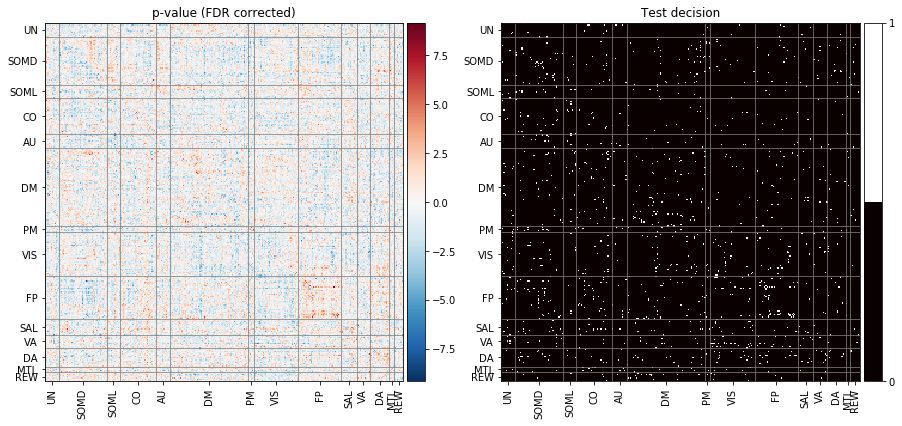

In [39]:
# Edge-wise one-sample two-sided t-test
results = [scipy.stats.ttest_1samp(beta_mats_all_sym[:, con, :, :, regressor_id], popmean=0, axis=0)
           for con in range(n_conditions)]

pvals = [result.pvalue for result in results]
pvals_fdr = [np.zeros(pval.shape) for pval in pvals]
triu_indices = np.triu_indices(n_rois)

# Multiple comparison correction
for con in range(n_conditions):
    _, pvals_fdr_flatten, _, _ = multipletests(pvals=pvals[con][triu_indices],
                                               alpha=.05, method='fdr_bh')
    pvals_fdr[con][triu_indices] = pvals_fdr_flatten
    pvals_fdr[con] = pvals_fdr[con] + pvals_fdr[con].T 

# Matrices to plot
statistic = np.triu(results[0].statistic, k=1) + np.tril(results[1].statistic, k=1)
decision = 1 * (np.triu(pvals_fdr[0] < 0.05, k=1) + np.tril(pvals_fdr[1] < 0.05, k=1))

# Plotting  
fig, axs = plt.subplots(ncols=2, figsize=(15, 7))

ims = [None] * 2

ims[0] = axs[0].imshow(statistic, cmap='RdBu_r', 
                       clim=[-np.max(np.abs(statistic)), np.max(np.abs(statistic))])
ims[1] = axs[1].imshow(decision, cmap=plt.cm.get_cmap('hot', 2))

axs[0].set_title('p-value (FDR corrected)')
axs[1].set_title('Test decision')

# LSN Division
for im, ax in zip(ims, axs):
    for boundary in boundaries:
        ax.axvline(x=boundary, color='grey', linewidth=1, alpha=.75)
        ax.axhline(y=boundary, color='grey', linewidth=1, alpha=.75)

    ax.set_xticks(tick_positions)
    ax.set_yticks(tick_positions)
    ax.set_xticklabels(df_atlas['netName_short'].unique(), rotation=90)
    ax.set_yticklabels(df_atlas['netName_short'].unique())

# Colorbars
divider = make_axes_locatable(axs[0])
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ims[0], cax=cax)
divider = make_axes_locatable(axs[1])
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ims[1], cax=cax, ticks=[0, 1])

plt.show()

### Plot mean LSN beta-weight matrices 


In [ ]:
fig, axs = plt.subplots(figsize=(10, 4), ncols=2)

ims = [None] * 2
ims[0] = axs[0].imshow(nets_mats_mean_sym[0, :, :, regressor_id], cmap='RdBu_r')
ims[1] = axs[1].imshow(nets_mats_mean_sym[1, :, :, regressor_id], cmap='RdBu_r')

ims[0].set_clim([-0.01, 0.01])
ims[1].set_clim([-0.01, 0.01])

In [ ]:
pval_thr = 0.05

results = scipy.stats.ttest_1samp(
    nets_mats_all_sym[:, 1, :, :, regressor_id], 
    popmean=0, 
    axis=0
)

pvals = results.pvalue
pvals_fdr = np.zeros(pvals.shape)
triu_indices = np.triu_indices(n_nets)

_, pvals_fdr_flatten, _, _ = multipletests(
    pvals=pvals[triu_indices],
    alpha=pval_thr,
    method='fdr_bh'
)

pvals_fdr[triu_indices] = pvals_fdr_flatten
pvals_fdr = pvals_fdr + pvals_fdr.T

# Plotting  
tstat = (pvals < pval_thr) * results.statistic

fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(tstat, cmap='RdBu_r', clim=[-np.max(np.abs(tstat)), np.max(np.abs(tstat))])

divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
plt.colorbar(im, cax=cax)

In [ ]:
positive_edges = np.sum((beta_mats_all_sym > 0), axis=(2, 3)) / (n_rois * (n_rois-1))

fig, ax = plt.subplots(ncols=2, figsize=(12, 4))

ax[0].hist(beta_mean[:, :, 4].flatten(), color='maroon', edgecolor='w')
ax[0].set_xlabel(r'Mean $\beta_{PPI:perr_{full}}$')
ax[0].set_ylabel('Frequency')

ax[1].hist(positive_edges[:, :, 4].flatten(), bins=np.linspace(0, 1, 21), color='blue', edgecolor='w')
ax[1].set_xlabel(r'% Positive edges')
ax[1].set_ylabel('Frequency')

plt.show()

In [ ]:
df_exclusion = pd.read_csv(
    os.path.join(path_root, 'data/main_fmri_study/derivatives/nistats/exclusion/exclusion.csv'),
    index_col=0
)
df_exclusion.head()

In [ ]:
beta_abs_mean = np.mean(np.abs(beta_mats_all_sym), axis=(0, 2, 3))
beta_abs_std = np.mean(np.std(np.abs(beta_mats_all_sym), axis=(2, 3)), axis=0)

In [ ]:
fig, ax = plt.subplots(figsize=(10, 4), facecolor='w')

colors = ['green', 'red']

for con in range(n_conditions):
    ax.plot(beta_abs_mean[con], 'o-', lineWidth=1, color=colors[con])

ax.plot([0, 9], [0, 0], '--', color='gray')